In [0]:
# importing neccessary libraries

import mlflow
mlflow.pyspark.ml.autolog()

In [0]:
# Creating a reusable file_path variable 
file_path = "/FileStore/tables/FaultDataset.csv"

In [0]:
# Replacing with the actual file path and reading data into DataFrame
faultDF = spark.read.csv(file_path, header = "True", inferSchema = "True")

In [0]:
# Displaying the first 5 rows of the DataFrame
faultDF.display(5)

1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,fault_detected
0.3503125,0.3496875,0.35,0.3459375,0.3475,0.3459375,0.341875,0.3434375,0.355,0.3553125,0.3459375,0.3525,0.3575,0.3590625,0.35875,0.3484375,0.3590625,0.35,0.3559375,0.3490625,0
0.5090625,0.484375,0.046875,0.071875,0.06,0.0634375,0.0575,0.0546875,0.0559375,0.058125,0.0628125,0.065625,0.0640625,0.0634375,0.0534375,0.084375,0.0615625,0.05375,0.076875,0.056875,0
0.0928125,0.0975,0.1096875,0.1025,0.09625,0.1053125,0.09875,0.098125,0.091875,0.0909375,0.09875,0.103125,0.1,0.1034375,0.1015625,0.0978125,0.0990625,0.10375,0.098125,0.1040625,0
0.09375,0.089375,0.091875,0.0996875,0.0909375,0.096875,0.0940625,0.096875,0.096875,0.099375,0.099375,0.0959375,0.0959375,0.0940625,0.09125,0.0996875,0.09375,0.0934375,0.0971875,0.094375,0
0.036875,0.0440625,0.038125,0.0428125,0.0353125,0.0340625,0.033125,0.0403125,0.0346875,0.036875,0.035625,0.03625,0.0409375,0.039375,0.035,0.040625,0.0384375,0.036875,0.04,0.0371875,0
0.135625,0.3034375,0.13875,0.140625,0.126875,0.130625,0.139375,0.143125,0.1290625,0.140625,0.1340625,0.1396875,0.1384375,0.1453125,0.1453125,0.1496875,0.1440625,0.1359375,0.1453125,0.14625,0
0.3446875,0.35125,0.3353125,0.3471875,0.34625,0.348125,0.3478125,0.3521875,0.3525,0.35125,0.3571875,0.360625,0.3640625,0.36625,0.3640625,0.3634375,0.3475,0.35375,0.1575,0.351875,0
0.036875,0.035625,0.03125,0.0375,0.0390625,0.034375,0.0315625,0.031875,0.0378125,0.0321875,0.0371875,0.038125,0.035,0.0353125,0.0325,0.03,0.0325,0.0321875,0.0321875,0.03125,0
0.0371875,0.039375,0.033125,0.04,0.04125,0.03875,0.035625,0.0384375,0.0378125,0.0365625,0.033125,0.0365625,0.03375,0.034375,0.0346875,0.04125,0.0365625,0.035,0.034375,0.0396875,0
0.3590625,0.3609375,0.360625,0.3590625,0.355,0.365,0.355625,0.358125,0.3575,0.3578125,0.355625,0.3584375,0.3521875,0.3459375,0.3521875,0.3509375,0.3525,0.35625,0.353125,0.3540625,0


In [0]:
faultDF.printSchema()

root
 |-- 1: double (nullable = true)
 |-- 2: double (nullable = true)
 |-- 3: double (nullable = true)
 |-- 4: double (nullable = true)
 |-- 5: double (nullable = true)
 |-- 6: double (nullable = true)
 |-- 7: double (nullable = true)
 |-- 8: double (nullable = true)
 |-- 9: double (nullable = true)
 |-- 10: double (nullable = true)
 |-- 11: double (nullable = true)
 |-- 12: double (nullable = true)
 |-- 13: double (nullable = true)
 |-- 14: double (nullable = true)
 |-- 15: double (nullable = true)
 |-- 16: double (nullable = true)
 |-- 17: double (nullable = true)
 |-- 18: double (nullable = true)
 |-- 19: double (nullable = true)
 |-- 20: double (nullable = true)
 |-- fault_detected: integer (nullable = true)



In [0]:
# Checking the dimensions of the dataframe

records_count = faultDF.count()
features_count = len(faultDF.columns)

print(f"records in the dataset: {records_count}")
print(f"features in the dataset: {features_count}")

records in the dataset: 9292
features in the dataset: 21


In [0]:
# Exploring the statistical summary of the data

statistical_distribution = faultDF.describe()

statistical_distribution.display()

summary,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,fault_detected
count,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292,9292
mean,0.34162330499354226,0.34263116121394677,0.3421213812957383,0.34213907124407966,0.3428434405940584,0.3428279366659492,0.3427147008179088,0.34306577566724017,0.34317299155187225,0.3439251842983209,0.3441075320167876,0.34398424047567727,0.3441183275936292,0.3448787599547991,0.34489994753551373,0.3458342525828662,0.34563488753766686,0.3457525290572536,0.3465221427034015,0.346670724817048,0.5
stddev,0.28919489486260785,0.2890875372793958,0.28916422490616933,0.28916356333107296,0.2889646554403878,0.2890889899729543,0.2891948159883224,0.28919185608065456,0.2893401858067147,0.289011538534877,0.28920014487495876,0.2890708129465896,0.28911804701463106,0.2889821392646809,0.2891314011350137,0.2888285654988746,0.28892040336707314,0.28915028148431343,0.2887705775702368,0.28900135543931055,0.5000269070362092
min,0.024375,0.024375,0.024375,0.024375,0.024375,0.024375,0.024375,0.024375,0.024375,0.024375,0.024375,0.024375,0.025,0.025,0.025,0.024375,0.024375,0.024375,0.024375,0.025,0
max,1.0809375,1.2134375,1.0809375,1.0809375,1.0809375,1.0809375,1.0809375,1.0809375,1.0809375,1.0809375,1.0809375,1.2134375,1.0809375,1.2134375,1.0809375,1.0809375,1.0809375,1.0809375,1.0809375,1.0809375,1


BAR CHART

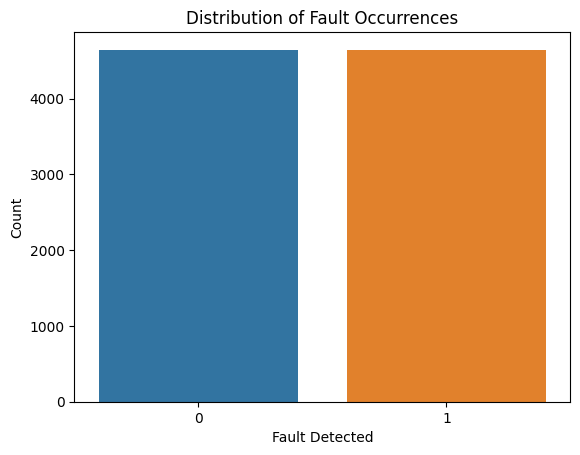

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

# Converting the DataFrame to a Pandas DataFrame
fault_DF = faultDF.toPandas()

# Plotting a bar chart of fault occurrences
sns.countplot(x='fault_detected', data=fault_DF)
plt.xlabel('Fault Detected')
plt.ylabel('Count')
plt.title('Distribution of Fault Occurrences')
plt.show()


CORRELATION HEAT MAP

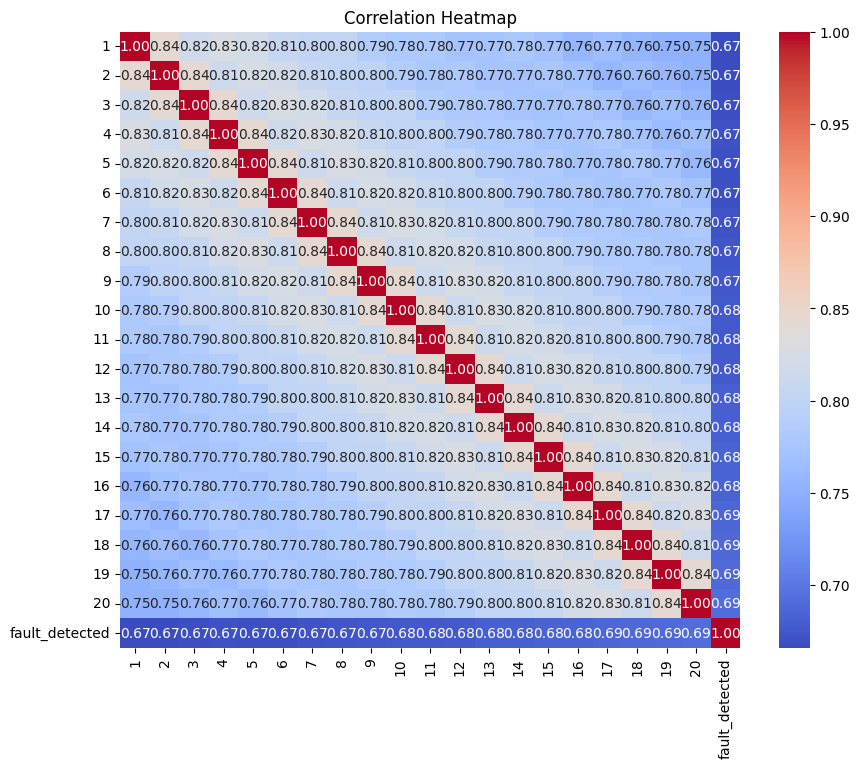

In [0]:
plt.figure(figsize=(10, 8)) 

# Computing the correlation matrix
correlation_matrix = fault_DF.corr()

# Creating a heatmap
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('Correlation Heatmap')
plt.show()


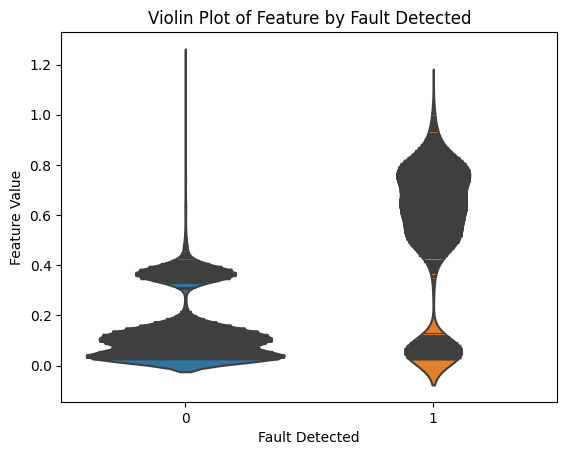

In [0]:
# Creating a violin plot
sns.violinplot(x='fault_detected', y='2', data=fault_DF, inner='stick')
plt.xlabel('Fault Detected')
plt.ylabel('Feature Value')
plt.title('Violin Plot of Feature by Fault Detected')
plt.show()


##### TRAINING A DECISION TREE MODEL

In [0]:
# importing necessary features
from pyspark.ml.feature import RFormula

# Preprocessing data into the right format
preprocess = RFormula(formula="fault_detected ~ .")
faultDF = preprocess.fit(faultDF).transform(faultDF)

2023/04/28 13:34:51 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'da65f159c6904cedbdabd134776fb316', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current pyspark.ml workflow


In [0]:
display(faultDF)

1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,fault_detected,features,label
0.3503125,0.3496875,0.35,0.3459375,0.3475,0.3459375,0.341875,0.3434375,0.355,0.3553125,0.3459375,0.3525,0.3575,0.3590625,0.35875,0.3484375,0.3590625,0.35,0.3559375,0.3490625,0,"Map(vectorType -> dense, length -> 20, values -> List(0.3503125, 0.3496875, 0.35, 0.3459375, 0.3475, 0.3459375, 0.341875, 0.3434375, 0.355, 0.3553125, 0.3459375, 0.3525, 0.3575, 0.3590625, 0.35875, 0.3484375, 0.3590625, 0.35, 0.3559375, 0.3490625))",0.0
0.5090625,0.484375,0.046875,0.071875,0.06,0.0634375,0.0575,0.0546875,0.0559375,0.058125,0.0628125,0.065625,0.0640625,0.0634375,0.0534375,0.084375,0.0615625,0.05375,0.076875,0.056875,0,"Map(vectorType -> dense, length -> 20, values -> List(0.5090625, 0.484375, 0.046875, 0.071875, 0.06, 0.0634375, 0.0575, 0.0546875, 0.0559375, 0.058125, 0.0628125, 0.065625, 0.0640625, 0.0634375, 0.0534375, 0.084375, 0.0615625, 0.05375, 0.076875, 0.056875))",0.0
0.0928125,0.0975,0.1096875,0.1025,0.09625,0.1053125,0.09875,0.098125,0.091875,0.0909375,0.09875,0.103125,0.1,0.1034375,0.1015625,0.0978125,0.0990625,0.10375,0.098125,0.1040625,0,"Map(vectorType -> dense, length -> 20, values -> List(0.0928125, 0.0975, 0.1096875, 0.1025, 0.09625, 0.1053125, 0.09875, 0.098125, 0.091875, 0.0909375, 0.09875, 0.103125, 0.1, 0.1034375, 0.1015625, 0.0978125, 0.0990625, 0.10375, 0.098125, 0.1040625))",0.0
0.09375,0.089375,0.091875,0.0996875,0.0909375,0.096875,0.0940625,0.096875,0.096875,0.099375,0.099375,0.0959375,0.0959375,0.0940625,0.09125,0.0996875,0.09375,0.0934375,0.0971875,0.094375,0,"Map(vectorType -> dense, length -> 20, values -> List(0.09375, 0.089375, 0.091875, 0.0996875, 0.0909375, 0.096875, 0.0940625, 0.096875, 0.096875, 0.099375, 0.099375, 0.0959375, 0.0959375, 0.0940625, 0.09125, 0.0996875, 0.09375, 0.0934375, 0.0971875, 0.094375))",0.0
0.036875,0.0440625,0.038125,0.0428125,0.0353125,0.0340625,0.033125,0.0403125,0.0346875,0.036875,0.035625,0.03625,0.0409375,0.039375,0.035,0.040625,0.0384375,0.036875,0.04,0.0371875,0,"Map(vectorType -> dense, length -> 20, values -> List(0.036875, 0.0440625, 0.038125, 0.0428125, 0.0353125, 0.0340625, 0.033125, 0.0403125, 0.0346875, 0.036875, 0.035625, 0.03625, 0.0409375, 0.039375, 0.035, 0.040625, 0.0384375, 0.036875, 0.04, 0.0371875))",0.0
0.135625,0.3034375,0.13875,0.140625,0.126875,0.130625,0.139375,0.143125,0.1290625,0.140625,0.1340625,0.1396875,0.1384375,0.1453125,0.1453125,0.1496875,0.1440625,0.1359375,0.1453125,0.14625,0,"Map(vectorType -> dense, length -> 20, values -> List(0.135625, 0.3034375, 0.13875, 0.140625, 0.126875, 0.130625, 0.139375, 0.143125, 0.1290625, 0.140625, 0.1340625, 0.1396875, 0.1384375, 0.1453125, 0.1453125, 0.1496875, 0.1440625, 0.1359375, 0.1453125, 0.14625))",0.0
0.3446875,0.35125,0.3353125,0.3471875,0.34625,0.348125,0.3478125,0.3521875,0.3525,0.35125,0.3571875,0.360625,0.3640625,0.36625,0.3640625,0.3634375,0.3475,0.35375,0.1575,0.351875,0,"Map(vectorType -> dense, length -> 20, values -> List(0.3446875, 0.35125, 0.3353125, 0.3471875, 0.34625, 0.348125, 0.3478125, 0.3521875, 0.3525, 0.35125, 0.3571875, 0.360625, 0.3640625, 0.36625, 0.3640625, 0.3634375, 0.3475, 0.35375, 0.1575, 0.351875))",0.0
0.036875,0.035625,0.03125,0.0375,0.0390625,0.034375,0.0315625,0.031875,0.0378125,0.0321875,0.0371875,0.038125,0.035,0.0353125,0.0325,0.03,0.0325,0.0321875,0.0321875,0.03125,0,"Map(vectorType -> dense, length -> 20, values -> List(0.036875, 0.035625, 0.03125, 0.0375, 0.0390625, 0.034375, 0.0315625, 0.031875, 0.0378125, 0.0321875, 0.0371875, 0.038125, 0.035, 0.0353125, 0.0325, 0.03, 0.0325, 0.0321875, 0.0321875, 0.03125))",0.0
0.0371875,0.039375,0.033125,0.04,0.04125,0.03875,0.035625,0.0384375,0.0378125,0.0365625,0.033125,0.0365625,0.03375,0.034375,0.0346875,0.04125,0.0365625,0.035,0.034375,0.0396875,0,"Map(vectorType -> dense, length -> 20, values -> List(0.0371875, 0.039375, 0.033125, 0.04, 0.04125, 0.03875, 0.035625, 0.0384375, 0.0378125, 0.0365625, 0.033125, 0.0365625, 0.03375, 0.034375, 0.034

In [0]:
# Spliting the data into training and test sets (70/30 split)

(training_data, test_data) = faultDF.randomSplit([0.7, 0.3], seed=100)

In [0]:
# Training a Decision Tree classification model using MLlib
from pyspark.ml.classification import DecisionTreeClassifier

dt = DecisionTreeClassifier(labelCol="label", featuresCol="features")

In [0]:
# Fitting the model to training data
model = dt.fit(training_data)

2023/04/28 13:34:52 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'a69a3f8d473c4242ae6c611b3c9fd81a', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current pyspark.ml workflow
2023/04/28 13:34:55 WARNING mlflow.pyspark.ml: Model inputs contain unsupported Spark data types: [StructField('features', VectorUDT(), True)]. Model signature is not logged.
2023/04/28 13:34:59 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().
2023/04/28 13:35:50 WARNING mlflow.utils.autologging_utils: MLflow autologging encountered a warning: "/databricks/python/lib/python3.10/site-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils."


In [0]:
# Evaluating the model's performance on the test data
predictions = model.transform(test_data)
display(predictions)

1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,fault_detected,features,label,rawPrediction,probability,prediction
0.0253125,0.039375,0.0528125,0.056875,0.0725,0.041875,0.5109375,0.5628125,0.605,0.6025,0.6259375,0.6,0.6090625,0.6034375,0.594375,0.6021875,0.580625,0.5703125,0.0503125,0.069375,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0253125, 0.039375, 0.0528125, 0.056875, 0.0725, 0.041875, 0.5109375, 0.5628125, 0.605, 0.6025, 0.6259375, 0.6, 0.6090625, 0.6034375, 0.594375, 0.6021875, 0.580625, 0.5703125, 0.0503125, 0.069375))",1.0,"Map(vectorType -> dense, length -> 2, values -> List(12.0, 139.0))","Map(vectorType -> dense, length -> 2, values -> List(0.07947019867549669, 0.9205298013245033))",1.0
0.02625,0.0325,0.0296875,0.0353125,0.0328125,0.0265625,0.03125,0.0328125,0.029375,0.0284375,0.0334375,0.0321875,0.0296875,0.0325,0.0284375,0.0259375,0.03125,0.02875,0.0328125,0.0334375,1,"Map(vectorType -> dense, length -> 20, values -> List(0.02625, 0.0325, 0.0296875, 0.0353125, 0.0328125, 0.0265625, 0.03125, 0.0328125, 0.029375, 0.0284375, 0.0334375, 0.0321875, 0.0296875, 0.0325, 0.0284375, 0.0259375, 0.03125, 0.02875, 0.0328125, 0.0334375))",1.0,"Map(vectorType -> dense, length -> 2, values -> List(3155.0, 142.0))","Map(vectorType -> dense, length -> 2, values -> List(0.9569305429178041, 0.043069457082195936))",0.0
0.02625,0.0334375,0.0271875,0.0275,0.02625,0.034375,0.0321875,0.031875,0.031875,0.0346875,0.0340625,0.0303125,0.03375,0.03125,0.0290625,0.0325,0.0328125,0.029375,0.0253125,0.039375,1,"Map(vectorType -> dense, length -> 20, values -> List(0.02625, 0.0334375, 0.0271875, 0.0275, 0.02625, 0.034375, 0.0321875, 0.031875, 0.031875, 0.0346875, 0.0340625, 0.0303125, 0.03375, 0.03125, 0.0290625, 0.0325, 0.0328125, 0.029375, 0.0253125, 0.039375))",1.0,"Map(vectorType -> dense, length -> 2, values -> List(3155.0, 142.0))","Map(vectorType -> dense, length -> 2, values -> List(0.9569305429178041, 0.043069457082195936))",0.0
0.0265625,0.0284375,0.02625,0.0325,0.0296875,0.0353125,0.0328125,0.0265625,0.03125,0.0328125,0.029375,0.0284375,0.0334375,0.0321875,0.0296875,0.0325,0.0284375,0.0259375,0.03125,0.02875,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0265625, 0.0284375, 0.02625, 0.0325, 0.0296875, 0.0353125, 0.0328125, 0.0265625, 0.03125, 0.0328125, 0.029375, 0.0284375, 0.0334375, 0.0321875, 0.0296875, 0.0325, 0.0284375, 0.0259375, 0.03125, 0.02875))",1.0,"Map(vectorType -> dense, length -> 2, values -> List(3155.0, 142.0))","Map(vectorType -> dense, length -> 2, values -> List(0.9569305429178041, 0.043069457082195936))",0.0
0.0265625,0.02875,0.0321875,0.0290625,0.0271875,0.0265625,0.0296875,0.0278125,0.0284375,0.0271875,0.0284375,0.0309375,0.0309375,0.02875,0.0340625,0.0296875,0.03125,0.0359375,0.671875,0.0640625,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0265625, 0.02875, 0.0321875, 0.0290625, 0.0271875, 0.0265625, 0.0296875, 0.0278125, 0.0284375, 0.0271875, 0.0284375, 0.0309375, 0.0309375, 0.02875, 0.0340625, 0.0296875, 0.03125, 0.0359375, 0.671875, 0.0640625))",1.0,"Map(vectorType -> dense, length -> 2, values -> List(0.0, 104.0))","Map(vectorType -> dense, length -> 2, values -> List(0.0, 1.0))",1.0
0.0265625,0.0315625,0.0296875,0.0321875,0.0275,0.0315625,0.03625,0.03375,0.03375,0.0271875,0.030625,0.0334375,0.029375,0.02625,0.0353125,0.0346875,0.036875,0.0365625,0.03,0.0309375,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0265625, 0.0315625, 0.0296875, 0.0321875, 0.0275, 0.0315625, 0.03625, 0.03375, 0.03375, 0.0271875, 0.030625, 0.0334375, 0.029375, 0.02625, 0.0353125, 0.0346875, 0.036875, 0.0365625, 0.03, 0.0309375))",1.0,"Map(vectorType -> dense, length -> 2, values -> List(3155.0, 142.0))","Map(vectorType -> dense, length -> 2, values -> List(0.9569305429178041, 0.043069457082195936))",0.0
0.026875,0.024375,0.03,0.03375,0.02625,0.0334375,0.0271875,0.0275,0.02625,0.034375,0.0321875,0.031875,0.031875,0.0346875,0.0340625,0.0303125,0.03375,0.03125,0.0290625,0.0325,1,"M

In [0]:
from pyspark.ml.evaluation import MulticlassClassificationEvaluator

evaluator = MulticlassClassificationEvaluator(labelCol="label", predictionCol="prediction", metricName="accuracy")

accuracy = evaluator.evaluate(predictions)

print("Accuracy = %g" % accuracy)


Accuracy = 0.952432


In [0]:
from pyspark.ml.tuning import ParamGridBuilder

# Creating a parameter grid

parameters = ParamGridBuilder()\
.addGrid(dt.impurity,["gini", "entropy"])\
.addGrid(dt.maxDepth, [3, 5, 7])\
.addGrid(dt.maxBins, [16, 32, 64])\
.build()

In [0]:
from pyspark.ml.tuning import TrainValidationSplit

# Defining the TrainValidationSplit object

tvs = TrainValidationSplit()\
.setSeed(100)\
.setTrainRatio(0.75)\
.setEstimatorParamMaps(parameters)\
.setEstimator(dt)\
.setEvaluator(evaluator)

In [0]:
# Training the model using grid search
gridSearchModel = tvs.fit(training_data)

2023/04/28 13:35:54 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'd01df7b50d0e447e92500109dc1c9ba3', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current pyspark.ml workflow
2023/04/28 13:36:42 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().
2023/04/28 13:37:43 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


In [0]:
# Using the best model to identify the optimum parameters

bestModel = gridSearchModel.bestModel

print("Parameters for the best model:")
print("MaxDepth Parameter: %g" %bestModel.getMaxDepth())
print("Impurity Parameter: %s" %bestModel.getImpurity())
print("MaxBins Parameter: %g" %bestModel.getMaxBins())

Parameters for the best model:
MaxDepth Parameter: 7
Impurity Parameter: entropy
MaxBins Parameter: 64


In [0]:
# Using the best model to make predictions on the test data

evaluator.evaluate(bestModel.transform(test_data))

0.961081081081081

In [0]:
import mlflow
logged_model = 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model'

# Load model
loaded_model = mlflow.spark.load_model(logged_model)

# Perform inference via model.transform()
loaded_predictions = loaded_model.transform(test_data)

loaded_predictions = loaded_predictions.select("fault_detected", "features", "label", "rawPrediction", "probability", "prediction")

loaded_predictions.show()

2023/04/28 13:38:36 INFO mlflow.spark: 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model' resolved as 'dbfs:/databricks/mlflow-tracking/536797586913510/8ea4439bcfbe4a209d5b467d91fdb387/artifacts/best_model'
2023/04/28 13:38:38 INFO mlflow.spark: URI 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model/sparkml' does not point to the current DFS.
2023/04/28 13:38:38 INFO mlflow.spark: File 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model/sparkml' not found on DFS. Will attempt to upload the file.
2023/04/28 13:38:40 INFO mlflow.spark: Copied SparkML model to /tmp/mlflow/104fb35a-2875-462d-8244-26459a737af9


+--------------+--------------------+-----+-------------+--------------------+----------+
|fault_detected|            features|label|rawPrediction|         probability|prediction|
+--------------+--------------------+-----+-------------+--------------------+----------+
|             1|[0.0253125,0.0393...|  1.0|   [1.0,38.0]|[0.02564102564102...|       1.0|
|             1|[0.02625,0.0325,0...|  1.0|[1010.0,44.0]|[0.95825426944971...|       0.0|
|             1|[0.02625,0.033437...|  1.0|[1010.0,44.0]|[0.95825426944971...|       0.0|
|             1|[0.0265625,0.0284...|  1.0|[1010.0,44.0]|[0.95825426944971...|       0.0|
|             1|[0.0265625,0.0287...|  1.0|   [0.0,80.0]|           [0.0,1.0]|       1.0|
|             1|[0.0265625,0.0315...|  1.0|[1010.0,44.0]|[0.95825426944971...|       0.0|
|             1|[0.026875,0.02437...|  1.0|[1010.0,44.0]|[0.95825426944971...|       0.0|
|             1|[0.0271875,0.0275...|  1.0| [26.0,138.0]|[0.15853658536585...|       1.0|
|         

#####  TRAINING A LOGISTIC REGRESSION MODEL

In [0]:
# Loading the dataset into a DataFrame
faultDF1 = spark.read.csv("/FileStore/tables/FaultDataset.csv", header=True, inferSchema=True)

In [0]:
# Displaying the dataframe
faultDF1.display()

1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,fault_detected
0.3503125,0.3496875,0.35,0.3459375,0.3475,0.3459375,0.341875,0.3434375,0.355,0.3553125,0.3459375,0.3525,0.3575,0.3590625,0.35875,0.3484375,0.3590625,0.35,0.3559375,0.3490625,0
0.5090625,0.484375,0.046875,0.071875,0.06,0.0634375,0.0575,0.0546875,0.0559375,0.058125,0.0628125,0.065625,0.0640625,0.0634375,0.0534375,0.084375,0.0615625,0.05375,0.076875,0.056875,0
0.0928125,0.0975,0.1096875,0.1025,0.09625,0.1053125,0.09875,0.098125,0.091875,0.0909375,0.09875,0.103125,0.1,0.1034375,0.1015625,0.0978125,0.0990625,0.10375,0.098125,0.1040625,0
0.09375,0.089375,0.091875,0.0996875,0.0909375,0.096875,0.0940625,0.096875,0.096875,0.099375,0.099375,0.0959375,0.0959375,0.0940625,0.09125,0.0996875,0.09375,0.0934375,0.0971875,0.094375,0
0.036875,0.0440625,0.038125,0.0428125,0.0353125,0.0340625,0.033125,0.0403125,0.0346875,0.036875,0.035625,0.03625,0.0409375,0.039375,0.035,0.040625,0.0384375,0.036875,0.04,0.0371875,0
0.135625,0.3034375,0.13875,0.140625,0.126875,0.130625,0.139375,0.143125,0.1290625,0.140625,0.1340625,0.1396875,0.1384375,0.1453125,0.1453125,0.1496875,0.1440625,0.1359375,0.1453125,0.14625,0
0.3446875,0.35125,0.3353125,0.3471875,0.34625,0.348125,0.3478125,0.3521875,0.3525,0.35125,0.3571875,0.360625,0.3640625,0.36625,0.3640625,0.3634375,0.3475,0.35375,0.1575,0.351875,0
0.036875,0.035625,0.03125,0.0375,0.0390625,0.034375,0.0315625,0.031875,0.0378125,0.0321875,0.0371875,0.038125,0.035,0.0353125,0.0325,0.03,0.0325,0.0321875,0.0321875,0.03125,0
0.0371875,0.039375,0.033125,0.04,0.04125,0.03875,0.035625,0.0384375,0.0378125,0.0365625,0.033125,0.0365625,0.03375,0.034375,0.0346875,0.04125,0.0365625,0.035,0.034375,0.0396875,0
0.3590625,0.3609375,0.360625,0.3590625,0.355,0.365,0.355625,0.358125,0.3575,0.3578125,0.355625,0.3584375,0.3521875,0.3459375,0.3521875,0.3509375,0.3525,0.35625,0.353125,0.3540625,0


In [0]:
# printing the schema
faultDF1.printSchema()

root
 |-- 1: double (nullable = true)
 |-- 2: double (nullable = true)
 |-- 3: double (nullable = true)
 |-- 4: double (nullable = true)
 |-- 5: double (nullable = true)
 |-- 6: double (nullable = true)
 |-- 7: double (nullable = true)
 |-- 8: double (nullable = true)
 |-- 9: double (nullable = true)
 |-- 10: double (nullable = true)
 |-- 11: double (nullable = true)
 |-- 12: double (nullable = true)
 |-- 13: double (nullable = true)
 |-- 14: double (nullable = true)
 |-- 15: double (nullable = true)
 |-- 16: double (nullable = true)
 |-- 17: double (nullable = true)
 |-- 18: double (nullable = true)
 |-- 19: double (nullable = true)
 |-- 20: double (nullable = true)
 |-- fault_detected: integer (nullable = true)



In [0]:
from pyspark.ml.feature import VectorAssembler

# Assembling features
assembler = VectorAssembler(inputCols=faultDF1.columns[:-1], outputCol="features")

In [0]:
from pyspark.ml.classification import LogisticRegression

# Building the Logistic Regression model
lr = LogisticRegression(featuresCol="features", labelCol="fault_detected")

In [0]:
from pyspark.ml import Pipeline

# Creating a pipeline
pipeline = Pipeline(stages=[assembler, lr])

In [0]:
# Splitting the data into training and test sets
lr_trainingdata, lr_testdata = faultDF1.randomSplit([0.7, 0.3], seed=42)

In [0]:
# Training the model
model = pipeline.fit(lr_trainingdata)

2023/04/28 13:38:45 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'e99c500b2f914042b28740728b46d47a', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current pyspark.ml workflow
2023/04/28 13:38:52 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


In [0]:
# Performing inference on the test data
lr_predictions = model.transform(lr_testdata)

In [0]:
# Dipslaying the predictions
lr_predictions.display()

1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,fault_detected,features,rawPrediction,probability,prediction
0.0253125,0.0259375,0.0284375,0.0296875,0.0340625,0.0328125,0.0328125,0.0325,0.025,0.0334375,0.035625,0.02875,0.0334375,0.03,0.030625,0.026875,0.02875,0.0359375,0.035,0.03875,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0253125, 0.0259375, 0.0284375, 0.0296875, 0.0340625, 0.0328125, 0.0328125, 0.0325, 0.025, 0.0334375, 0.035625, 0.02875, 0.0334375, 0.03, 0.030625, 0.026875, 0.02875, 0.0359375, 0.035, 0.03875))","Map(vectorType -> dense, length -> 2, values -> List(3.1598119072496034, -3.1598119072496034))","Map(vectorType -> dense, length -> 2, values -> List(0.9592936021564197, 0.04070639784358032))",0.0
0.0259375,0.0284375,0.0296875,0.0340625,0.0328125,0.0328125,0.0325,0.025,0.0334375,0.035625,0.02875,0.0334375,0.03,0.030625,0.026875,0.02875,0.0359375,0.035,0.03875,0.034375,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0259375, 0.0284375, 0.0296875, 0.0340625, 0.0328125, 0.0328125, 0.0325, 0.025, 0.0334375, 0.035625, 0.02875, 0.0334375, 0.03, 0.030625, 0.026875, 0.02875, 0.0359375, 0.035, 0.03875, 0.034375))","Map(vectorType -> dense, length -> 2, values -> List(3.153754145428486, -3.153754145428486))","Map(vectorType -> dense, length -> 2, values -> List(0.9590563910054946, 0.04094360899450544))",0.0
0.0259375,0.0328125,0.0340625,0.03375,0.0309375,0.0309375,0.034375,0.030625,0.029375,0.029375,0.026875,0.030625,0.0284375,0.03125,0.0271875,0.0278125,0.0290625,0.0278125,0.0309375,0.0290625,0,"Map(vectorType -> dense, length -> 20, values -> List(0.0259375, 0.0328125, 0.0340625, 0.03375, 0.0309375, 0.0309375, 0.034375, 0.030625, 0.029375, 0.029375, 0.026875, 0.030625, 0.0284375, 0.03125, 0.0271875, 0.0278125, 0.0290625, 0.0278125, 0.0309375, 0.0290625))","Map(vectorType -> dense, length -> 2, values -> List(3.183790552847519, -3.183790552847519))","Map(vectorType -> dense, length -> 2, values -> List(0.9602197097510491, 0.03978029024895091))",0.0
0.02625,0.025625,0.0290625,0.0265625,0.0353125,0.0259375,0.0328125,0.0340625,0.03375,0.0309375,0.0309375,0.034375,0.030625,0.029375,0.029375,0.026875,0.030625,0.0284375,0.03125,0.0271875,0,"Map(vectorType -> dense, length -> 20, values -> List(0.02625, 0.025625, 0.0290625, 0.0265625, 0.0353125, 0.0259375, 0.0328125, 0.0340625, 0.03375, 0.0309375, 0.0309375, 0.034375, 0.030625, 0.029375, 0.029375, 0.026875, 0.030625, 0.0284375, 0.03125, 0.0271875))","Map(vectorType -> dense, length -> 2, values -> List(3.1919262707904736, -3.1919262707904736))","Map(vectorType -> dense, length -> 2, values -> List(0.9605293154914512, 0.03947068450854885))",0.0
0.0265625,0.0253125,0.0259375,0.0284375,0.0296875,0.0340625,0.0328125,0.0328125,0.0325,0.025,0.0334375,0.035625,0.02875,0.0334375,0.03,0.030625,0.026875,0.02875,0.0359375,0.035,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0265625, 0.0253125, 0.0259375, 0.0284375, 0.0296875, 0.0340625, 0.0328125, 0.0328125, 0.0325, 0.025, 0.0334375, 0.035625, 0.02875, 0.0334375, 0.03, 0.030625, 0.026875, 0.02875, 0.0359375, 0.035))","Map(vectorType -> dense, length -> 2, values -> List(3.1739575304474936, -3.1739575304474936))","Map(vectorType -> dense, length -> 2, values -> List(0.9598424053489095, 0.04015759465109048))",0.0
0.0265625,0.0284375,0.02625,0.0325,0.0296875,0.0353125,0.0328125,0.0265625,0.03125,0.0328125,0.029375,0.0284375,0.0334375,0.0321875,0.0296875,0.0325,0.0284375,0.0259375,0.03125,0.02875,1,"Map(vectorType -> dense, length -> 20, values -> List(0.0265625, 0.0284375, 0.02625, 0.0325, 0.0296875, 0.0353125, 0.0328125, 0.0265625, 0.03125, 0.0328125, 0.029375, 0.0284375, 0.0334375, 0.0321875, 0.0296875, 0.0325, 0.0284375, 0.0259375, 0.03125, 0.02875))","Map(vectorType -> dense, length -> 2, values -> List(3.1862125922827715, -3.1862125922827715))","Map(vectorType -> dense, length -> 2, values -> List(0.9603121233185835, 0.03968787668141649))",0.0
0.0265625,0.02875,0.0321875,0.0290625,0.0271875,0.0265

In [0]:
# Defining a hyperparameter grid for the grid search
param_grid = ParamGridBuilder() \
    .addGrid(lr.regParam, [0.01, 0.1, 1.0]) \
    .addGrid(lr.elasticNetParam, [0.0, 0.5, 1.0]) \
    .addGrid(lr.maxIter, [10, 20, 30]) \
    .build()

In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator

# Creating the evaluator
evaluator = BinaryClassificationEvaluator(labelCol="fault_detected", rawPredictionCol="rawPrediction", metricName="areaUnderROC")

In [0]:
# Created a TrainValidationSplit with pipeline and hyperparameter grid
tvs = TrainValidationSplit(estimator=pipeline,
                           estimatorParamMaps=param_grid,
                           evaluator=evaluator,
                           trainRatio=0.8) 

In [0]:
# Fitted the model with the training data
tvs_model = tvs.fit(lr_trainingdata)

2023/04/28 13:39:48 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '5eea4dbb89b145beb98ec28de9ff1b1b', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current pyspark.ml workflow
2023/04/28 13:41:34 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().
2023/04/28 13:42:40 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


In [0]:
# Made predictions on the test data
lr_predictions = tvs_model.transform(lr_testdata)

In [0]:
# Evaluating the model
roc = evaluator.evaluate(lr_predictions)

In [0]:
# Printing the best hyperparameters and area under ROC

best_model = tvs_model.bestModel
best_reg_param = best_model.stages[1].getOrDefault('regParam')
best_elastic_net_param = best_model.stages[1].getOrDefault('elasticNetParam')
best_max_iter = best_model.stages[1].getOrDefault('maxIter')

print("The best hyperparameters are:")
print("regParam: ", best_reg_param)
print("elasticNetParam: ", best_elastic_net_param)
print("maxIter: ", best_max_iter)
print("Area under ROC: ", roc)

The best hyperparameters are:
regParam:  0.01
elasticNetParam:  1.0
maxIter:  30
Area under ROC:  0.9305369680389571


#####  TRAINING A RANDOM FOREST MODEL

In [0]:
# Splitting the data into training and test sets

(trainingData, testData) = faultDF1.randomSplit([0.7, 0.3])

In [0]:
from pyspark.ml.feature import VectorAssembler

# Using vector assembler to combine the features into a single  vector
assembler = VectorAssembler(inputCols=faultDF1.columns[:-1], outputCol="features")

In [0]:
# Transforming the data and selecting the relevant columns

trainingData = assembler.transform(trainingData).select("features", "fault_detected")
testData = assembler.transform(testData).select("features", "fault_detected")

In [0]:
from pyspark.ml.classification import RandomForestClassifier

# Initializing a Random Forest Classifier
rf = RandomForestClassifier(labelCol="fault_detected", featuresCol="features")

In [0]:
# Training the model on the training data
model = rf.fit(trainingData)

2023/04/28 13:43:35 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID '3c76f85fe74a4450b612398404ed2860', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current pyspark.ml workflow
2023/04/28 13:43:44 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


In [0]:
from pyspark.ml.evaluation import BinaryClassificationEvaluator

# Evaluating the model using the test data 
predictions = model.transform(testData)
evaluator = BinaryClassificationEvaluator(labelCol="fault_detected", rawPredictionCol="rawPrediction")
auc = evaluator.evaluate(predictions)

In [0]:
# Retrieving the feature importances from the trained model
importances = model.featureImportances
print(importances)

(20,[0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19],[0.01555858398218411,0.0351545123148431,0.031180190000550206,0.021335426079045577,0.016688574871118432,0.0016809724456115643,0.00591350742784345,0.011452239413757344,0.006724529565242971,0.008047818278154976,0.038372803378923986,0.040315676225846406,0.019806138673844467,0.04218553328374101,0.15676413415557236,0.07590745090722323,0.29161217304142917,0.10831251218375128,0.036244669862615486,0.036742553908701056])


In [0]:
# Initializing a new Random Forest Classifier with an hyperparameter to tune
rf = RandomForestClassifier(featuresCol='features', labelCol='fault_detected', seed=42)

In [0]:
from pyspark.ml.tuning import ParamGridBuilder

# Defining the hyperparameter grid
param_grid = ParamGridBuilder() \
    .addGrid(rf.numTrees, [10, 20, 30]) \
    .addGrid(rf.maxDepth, [5, 10, 15]) \
    .build()

In [0]:
from pyspark.ml.tuning import TrainValidationSplit
from pyspark.ml.evaluation import BinaryClassificationEvaluator


# Setting up a TrainValidationSplit to search over the hyperparameter grid
evaluator = BinaryClassificationEvaluator(labelCol='fault_detected', rawPredictionCol='rawPrediction', metricName='areaUnderROC')

tvs = TrainValidationSplit(estimator=rf, estimatorParamMaps=param_grid, evaluator=evaluator, trainRatio=0.8, seed=123)

In [0]:
# Fitting it to the training data
model = tvs.fit(trainingData)

2023/04/28 13:44:38 INFO mlflow.utils.autologging_utils: Created MLflow autologging run with ID 'f99c7dc9a5ce48d5b96eb1474d10e7a7', which will track hyperparameters, performance metrics, model artifacts, and lineage information for the current pyspark.ml workflow
2023/04/28 13:45:34 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().
2023/04/28 13:46:38 INFO mlflow.spark: Inferring pip requirements by reloading the logged model from the databricks artifact repository, which can be time-consuming. To speed up, explicitly specify the conda_env or pip_requirements when calling log_model().


In [0]:
# Evaluating the best model using test data
predictions = model.transform(testData)
auc = evaluator.evaluate(predictions)
print(f"Area Under ROC = {auc}")

Area Under ROC = 0.9980712134375419


In [0]:
# Extracting the best hyperparameters from the trained model
best_model = model.bestModel
best_params = best_model.extractParamMap()

In [0]:
# Using the best model to make predictions 
predictions = best_model.transform(testData)
predictions.show()

+--------------------+--------------+--------------------+--------------------+----------+
|            features|fault_detected|       rawPrediction|         probability|prediction|
+--------------------+--------------+--------------------+--------------------+----------+
|[0.0253125,0.0259...|             1|[22.5053459528669...|[0.75017819842889...|       0.0|
|[0.0259375,0.0312...|             1|[10.6482299940557...|[0.35494099980185...|       1.0|
|[0.0259375,0.0328...|             0|[21.1744394803753...|[0.70581464934584...|       0.0|
|[0.02625,0.0325,0...|             1|[22.7613571237293...|[0.75871190412431...|       0.0|
|[0.0265625,0.0253...|             1|[18.8687851071381...|[0.62895950357127...|       0.0|
|[0.0265625,0.0284...|             1|[21.6125117593458...|[0.72041705864486...|       0.0|
|[0.0265625,0.0296...|             1|[6.33333333333333...|[0.21111111111111...|       1.0|
|[0.0265625,0.0315...|             1|[24.0807228811623...|[0.80269076270541...|       0.0|

###### COMPARING THE PERFORMANCE OF BOTH MODELS:
DECISION TREE vs LOGISTIC REGRESSION

In [0]:
# Performing inference on test data using the regression model

lr_logged_model = 'runs:/310fee3a4e2b4c7a9b1131fb1b6c15d0/best_model'
loaded_lr_model = mlflow.spark.load_model(lr_logged_model)
lr_predictions = loaded_lr_model.transform(lr_testdata)

2023/04/28 13:47:35 INFO mlflow.spark: 'runs:/310fee3a4e2b4c7a9b1131fb1b6c15d0/best_model' resolved as 'dbfs:/databricks/mlflow-tracking/2571355483479534/310fee3a4e2b4c7a9b1131fb1b6c15d0/artifacts/best_model'
2023/04/28 13:47:37 INFO mlflow.spark: URI 'runs:/310fee3a4e2b4c7a9b1131fb1b6c15d0/best_model/sparkml' does not point to the current DFS.
2023/04/28 13:47:37 INFO mlflow.spark: File 'runs:/310fee3a4e2b4c7a9b1131fb1b6c15d0/best_model/sparkml' not found on DFS. Will attempt to upload the file.
2023/04/28 13:47:39 INFO mlflow.spark: Copied SparkML model to /tmp/mlflow/603f05b8-893e-4371-80d1-cd628f9aa650


In [0]:
# Performing inference on test data using the decision tree model

dt_logged_model = 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model'
loaded_dt_model = mlflow.spark.load_model(dt_logged_model)
dt_predictions = loaded_dt_model.transform(test_data)


2023/04/28 13:47:42 INFO mlflow.spark: 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model' resolved as 'dbfs:/databricks/mlflow-tracking/536797586913510/8ea4439bcfbe4a209d5b467d91fdb387/artifacts/best_model'
2023/04/28 13:47:44 INFO mlflow.spark: URI 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model/sparkml' does not point to the current DFS.
2023/04/28 13:47:44 INFO mlflow.spark: File 'runs:/8ea4439bcfbe4a209d5b467d91fdb387/best_model/sparkml' not found on DFS. Will attempt to upload the file.
2023/04/28 13:47:45 INFO mlflow.spark: Copied SparkML model to /tmp/mlflow/6c48d73a-786b-4471-ad0e-1dcf9b304b21


In [0]:
# Comparing the results of both models

lr_predictions.select("fault_detected", "rawPrediction", "probability", "prediction").show(10)

dt_predictions.select("fault_detected", "rawPrediction", "probability", "prediction").show(10)

+--------------+--------------------+--------------------+----------+
|fault_detected|       rawPrediction|         probability|prediction|
+--------------+--------------------+--------------------+----------+
|             1|[2.86493298215331...|[0.94608547424465...|       0.0|
|             1|[2.85993161104465...|[0.94582979566321...|       0.0|
|             0|[2.88777656079290...|[0.94723887030614...|       0.0|
|             0|[2.89402427581856...|[0.94755024375555...|       0.0|
|             1|[2.87868697522897...|[0.94678274541146...|       0.0|
|             1|[2.88985433124132...|[0.94734261541270...|       0.0|
|             1|[2.20968479364849...|[0.90111584357036...|       0.0|
|             1|[2.86675736943470...|[0.94617845643666...|       0.0|
|             1|[-1.1334799380453...|[0.24351946256626...|       1.0|
|             0|[2.87191552885108...|[0.94644053086122...|       0.0|
+--------------+--------------------+--------------------+----------+
only showing top 10 